#Binarization of Historical Documents
Ghulam Hussain Khan

Mohammad Irfan

Abdul basit Sajid


Note :The paths here are according to our drive When someone runs the code he has to use the paths according to his data being stored also this notebook is written on colab and usese google drive for data if you want to run it on your local machine you have to change paths accordingly as well

In [ ]:
import os
from google.colab import drive
from google.colab.patches import cv2_imshow  # Use this for image display in Colab
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
import matplotlib.pyplot as plt

# Mount Google Drive
drive.mount('/content/gdrive')


preprocess function


In [ ]:


# Function to load and preprocess images
def load_and_preprocess_data(image_paths, gt_paths, target_size=(256, 256)):
    images = []
    ground_truth = []

    # Sort the image paths based on filenames without extension
    sorted_image_paths = sorted(image_paths)
    sorted_gt_paths = sorted(gt_paths)
    print(sorted_image_paths)
    print(sorted_gt_paths)

    for img_path, gt_path in zip(sorted_image_paths, sorted_gt_paths):
        print(f"Loading image: {img_path}")
        img = cv2.imread(img_path)

        print(f"Loading ground truth: {gt_path}")
        gt_img = cv2.imread(gt_path, cv2.IMREAD_GRAYSCALE)

        if img is None or gt_img is None:
            print(f"Error loading image or ground truth: {img_path}, {gt_path}")
            continue

        img = cv2.medianBlur(img, 5)
        # Resize images to the target size
        img = cv2.resize(img, target_size)
        gt_img = cv2.resize(gt_img, target_size)

        # Normalize pixel values to the range [0, 1]
        img = img.astype('float32') / 255.0
        gt_img = gt_img.astype('float32') / 255.0

        # Append images to the lists
        images.append(img)
        ground_truth.append(gt_img)

    # Convert lists to NumPy arrays
    images = np.array(images)
    ground_truth = np.array(ground_truth)

    return images, ground_truth




Get Training Data

In [ ]:
# Replace these paths with the actual paths to your image and ground truth folders
image_folder = '/content/gdrive/MyDrive/project/images'
gt_folder = '/content/gdrive/MyDrive/project/GT'

# Get lists of file paths for images and ground truth images
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder)]
gt_paths = [os.path.join(gt_folder, gt) for gt in os.listdir(gt_folder)]

# Sort the image paths based on filenames without extension
sorted_image_paths = sorted(image_paths)
sorted_gt_paths = sorted(gt_paths)

if len(sorted_image_paths) != len(sorted_gt_paths):
    raise ValueError("Inconsistent number of samples between image and ground truth datasets")
# Split the dataset into training and validation sets
# Assuming image_paths and gt_paths are lists of file paths
total_samples = len(sorted_image_paths)
split_index = int(0.8 * total_samples)

X_train, y_train = sorted_image_paths[:70], sorted_gt_paths[:70]
X_val, y_val = sorted_image_paths[70:], sorted_gt_paths[70:]

# Load and preprocess training data
X_train, y_train = load_and_preprocess_data(X_train, y_train)

# Load and preprocess validation data
X_val, y_val = load_and_preprocess_data(X_val, y_val)

# Print the shape of the training and validation datasets for verification
print("Training Data Shapes - X: {}, y: {}".format(X_train.shape, y_train.shape))
print("Validation Data Shapes - X: {}, y: {}".format(X_val.shape, y_val.shape))

create unet model

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models

def unet_model(input_shape,threshold=0.5):
    # Input layer
    inputs = tf.keras.Input(shape=input_shape, dtype=tf.float32)

    # Encoder
    conv1 = layers.Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = layers.Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = layers.MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = layers.Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = layers.Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = layers.MaxPooling2D(pool_size=(2, 2))(conv2)

    # Decoder
    up1 = layers.UpSampling2D(size=(2, 2))(pool2)
    concat1 = layers.Concatenate(axis=-1)([conv2, up1])
    conv3 = layers.Conv2D(128, 3, activation='relu', padding='same')(concat1)
    conv3 = layers.Conv2D(128, 3, activation='relu', padding='same')(conv3)

    up2 = layers.UpSampling2D(size=(2, 2))(conv3)
    concat2 = layers.Concatenate(axis=-1)([conv1, up2])
    conv4 = layers.Conv2D(64, 3, activation='relu', padding='same')(concat2)
    conv4 = layers.Conv2D(64, 3, activation='relu', padding='same')(conv4)

    # Output layer with 'sigmoid' activation for binary classification
    output = layers.Dense(1, activation='sigmoid')(conv4)

    # Create the model
    model = tf.keras.Model(inputs=inputs, outputs=output)


    return model
# Define input shape (adjust based on your image size and channels)
input_shape = (256, 256, 3)

# Create the U-Net model
model = unet_model(input_shape)

# Display the model summary
model.summary()


compile and train model

In [ ]:

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss=BinaryCrossentropy(), metrics=['accuracy'])

# Define the number of epochs and batch size
epochs = 200
batch_size = 10

# Train the model
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size)

# Evaluate the model on the validation set
eval_result = model.evaluate(X_val, y_val)
print("Validation Loss:", eval_result[0])
print("Validation Accuracy:", eval_result[1])


Epoch 1/200
7/7 [==============================] - 22s 551ms/step - loss: 0.6274 - accuracy: 0.8956 - val_loss: 0.5491 - val_accuracy: 0.8871
Epoch 2/200
7/7 [==============================] - 2s 355ms/step - loss: 0.4241 - accuracy: 0.8974 - val_loss: 0.3073 - val_accuracy: 0.8871
Epoch 3/200
7/7 [==============================] - 2s 356ms/step - loss: 0.3071 - accuracy: 0.8974 - val_loss: 0.3247 - val_accuracy: 0.8871
Epoch 4/200
7/7 [==============================] - 2s 362ms/step - loss: 0.2870 - accuracy: 0.8974 - val_loss: 0.3046 - val_accuracy: 0.8871
Epoch 5/200
7/7 [==============================] - 2s 360ms/step - loss: 0.2796 - accuracy: 0.8974 - val_loss: 0.2935 - val_accuracy: 0.8871
Epoch 6/200
7/7 [==============================] - 3s 397ms/step - loss: 0.2733 - accuracy: 0.8974 - val_loss: 0.2889 - val_accuracy: 0.8871
Epoch 7/200
7/7 [==============================] - 3s 401ms/step - loss: 0.2675 - accuracy: 0.8974 - val_loss: 0.2837 - val_accuracy: 0.8871
Epoch 8/200


saving the model


In [ ]:
# use only if you are training a new model and change path and name if you wish to
model.save('/content/gdrive/MyDrive/unet_binarizer3.keras')

plot history

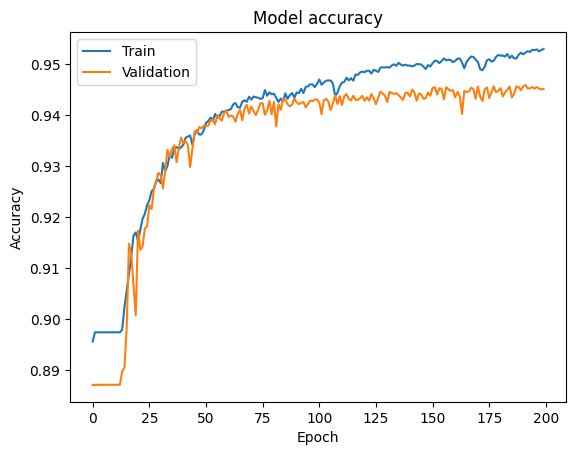

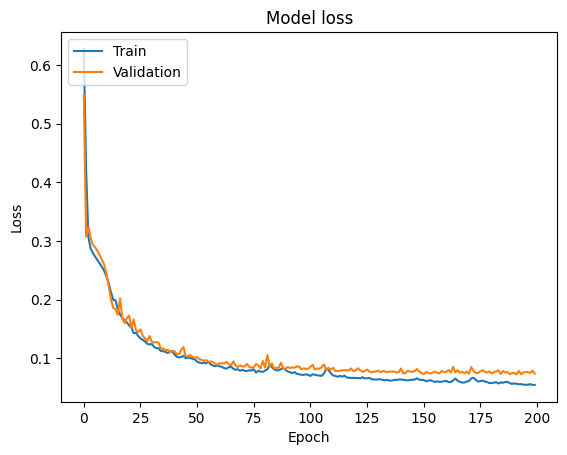

In [ ]:
def plot_training_history(history):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

# Plot the training history
plot_training_history(history)

function for denoising,binarization,erosion using Digital image processing techniques and also check the results of other commonly used thresolding algos like otsu niblack sauvola.

In [ ]:
def process_and_binarize_image(image_path):
    # Load the denoised RGB image
    noisy_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Denoise the image using Median Filter
    denoised_image = cv2.medianBlur(noisy_image, 5)
    # Apply adaptive thresholding
    block_size = 3  # Size of the neighborhood used for local threshold calculation
    adaptive_method = cv2.ADAPTIVE_THRESH_GAUSSIAN_C  # Adaptive thresholding method
    C = 5  # Constant added to the mean or median

    thresholded_image = cv2.adaptiveThreshold(denoised_image, 255, adaptive_method, cv2.THRESH_BINARY, block_size, C)

    kernel_size = 5
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    eroded_image = cv2.erode(thresholded_image, kernel, iterations=1)
    eroded_image =cv2.resize(eroded_image,(256,256))
    denoised_image = cv2.resize(denoised_image,(256,256))
    # Apply other common thresholding techniques
    _, otsu_image = cv2.threshold(denoised_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    sauvola_image = cv2.ximgproc.niBlackThreshold(denoised_image, 255, cv2.THRESH_BINARY, 21, 0.2)
    niblack_image = cv2.ximgproc.niBlackThreshold(denoised_image, 255, cv2.THRESH_BINARY, 21, -0.2)

    # Return all processed images
    return noisy_image, denoised_image, thresholded_image, eroded_image, otsu_image, sauvola_image, niblack_image


if you have trained a new model(not the saved one)than run this code

In [ ]:
# Assuming you have a new set of test images (X_test) for prediction
# Load and preprocess the test data similarly to the training data

# Replace these paths with the actual paths to your image and ground truth folders
image_folder = '/content/gdrive/MyDrive/test_images'
gt_folder = '/content/gdrive/MyDrive/test_gt'

# Get lists of file paths for images and ground truth images
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder)]
gt_paths = [os.path.join(gt_folder, gt) for gt in os.listdir(gt_folder)]

image_paths=sorted(image_paths)
gt_paths=sorted(gt_paths)
if len(image_paths) != len(gt_paths):
    raise ValueError("Inconsistent number of samples between image and ground truth datasets")
# Split the dataset into training and validation sets
X_test, y_test = load_and_preprocess_data(image_paths,gt_paths)
print(X_test.shape)
# Make predictions on the test set
predictions = model.predict(X_test)
binary_mask = (predictions > 0.5).astype(np.uint8)
# Visualize some results (you may need to adjust this based on your data)

def visualize_results(images, ground_truth, predictions, num_samples=28):
    for i in range(num_samples):
        noisy_img, denoised_img, thresholded_img, eroded_img, otsu_img, sauvola_img, niblack_img = process_and_binarize_image(image[i])
        plt.figure(figsize=(12, 10))

        # Original image
        plt.subplot(1, 3, 1)
        plt.imshow(images[i])
        plt.title('Original Image')

        # Ground truth
        plt.subplot(1, 3, 2)
        plt.imshow(ground_truth[i], cmap='gray')
        plt.title('Ground Truth')

        # Predicted mask
        plt.subplot(1, 3, 3)
        plt.imshow(predictions[i][:, :, 0], cmap='gray')
        plt.title('Predicted Mask')

        plt.subplot(1, 3, 4)
        plt.imshow( eroded_img)
        plt.title('eroded image')

        # Ground truth
        plt.subplot(1, 3, 5)
        plt.imshow(otsu_img, cmap='gray')
        plt.title('Otsu')

        # Predicted mask
        plt.subplot(1, 3, 6)
        plt.imshow( sauvola_img, cmap='gray')
        plt.title('Savoula')
        # Ground truth
        plt.subplot(1, 3, 7)
        plt.imshow( niblack_img, cmap='gray')
        plt.title('Niblack')

        plt.show()

# Visualize predictions on test samples
visualize_results(X_test, y_test, predictions)


NameError: ignored

function to visualize and compare all results

In [ ]:
def visualize_results(images, ground_truth, predictions,binary_masks, eroded_img, otsu_img, savoula_img, niblack_img, num_samples=35):
    for i in range(num_samples):
        plt.figure(figsize=(18, 15))  # Adjusted the figure size for better visualization

        # Original image
        plt.subplot(2, 4, 1)
        plt.imshow(images[i])
        plt.title('Original Image')

        # Ground truth
        plt.subplot(2, 4, 2)
        plt.imshow(ground_truth[i], cmap='gray')
        plt.title('Ground Truth')

        # Predicted mask
        plt.subplot(2, 4, 3)
        plt.imshow(predictions[i], cmap='gray')
        plt.title('Predicted Mask')

        # Binary mask
        plt.subplot(2, 4, 4)
        plt.imshow(binary_masks[i], cmap='gray')
        plt.title('Binary Mask')

        # Eroded image
        plt.subplot(2, 4, 5)
        plt.imshow(eroded_img[i], cmap='gray')
        plt.title('Eroded Image')

        # Otsu
        plt.subplot(2, 4, 6)
        plt.imshow(otsu_img[i], cmap='gray')
        plt.title('Otsu')

        # Savoula
        plt.subplot(2, 4, 7)
        plt.imshow(savoula_img[i], cmap='gray')
        plt.title('Savoula')

        # Niblack
        plt.subplot(2, 4, 8)
        plt.imshow(niblack_img[i], cmap='gray')
        plt.title('Niblack')

        # Show the plot for each sample
        plt.show()



if you are using a saved model than load it by using path on your machine

In [ ]:
from keras.models import load_model
unet_binarizer3 = load_model('/content/gdrive/MyDrive/unet_binarizer3.keras')
image_folder = '/content/gdrive/MyDrive/test_images'
gt_folder = '/content/gdrive/MyDrive/test_gt'

# Get lists of file paths for images and ground truth images
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder)]
gt_paths = [os.path.join(gt_folder, gt) for gt in os.listdir(gt_folder)]

image_paths=sorted(image_paths)
gt_paths=sorted(gt_paths)
if len(image_paths) != len(gt_paths):
    raise ValueError("Inconsistent number of samples between image and ground truth datasets")
# Split the dataset into training and validation sets
X_test, y_test = load_and_preprocess_data(image_paths,gt_paths)
print(X_test.shape)

# binary_mask = (predictions > 0.9).astype(np.uint8)
predictions2=unet_binarizer3.predict(X_test)
thresholded_predictions2= (predictions2 > 0.5).astype(np.uint8)

['/content/gdrive/MyDrive/test_images/H01.tif', '/content/gdrive/MyDrive/test_images/H02.jpg', '/content/gdrive/MyDrive/test_images/H03.tif', '/content/gdrive/MyDrive/test_images/H04.bmp', '/content/gdrive/MyDrive/test_images/H05.jpg', '/content/gdrive/MyDrive/test_images/H06.tif', '/content/gdrive/MyDrive/test_images/H07.jpg', '/content/gdrive/MyDrive/test_images/H08.jpg', '/content/gdrive/MyDrive/test_images/H09.jpg', '/content/gdrive/MyDrive/test_images/H10.jpg', '/content/gdrive/MyDrive/test_images/P01.bmp', '/content/gdrive/MyDrive/test_images/P02.bmp', '/content/gdrive/MyDrive/test_images/P03.bmp', '/content/gdrive/MyDrive/test_images/P04.bmp', '/content/gdrive/MyDrive/test_images/P05.bmp', '/content/gdrive/MyDrive/test_images/image0024.png', '/content/gdrive/MyDrive/test_images/image0027.png', '/content/gdrive/MyDrive/test_images/image0042.png', '/content/gdrive/MyDrive/test_images/image0048.png', '/content/gdrive/MyDrive/test_images/image0062.png', '/content/gdrive/MyDrive/test

2/2 [==============================] - 1s 34ms/step


Now compare the reults of AI and other techniques through visualization in matplotlib

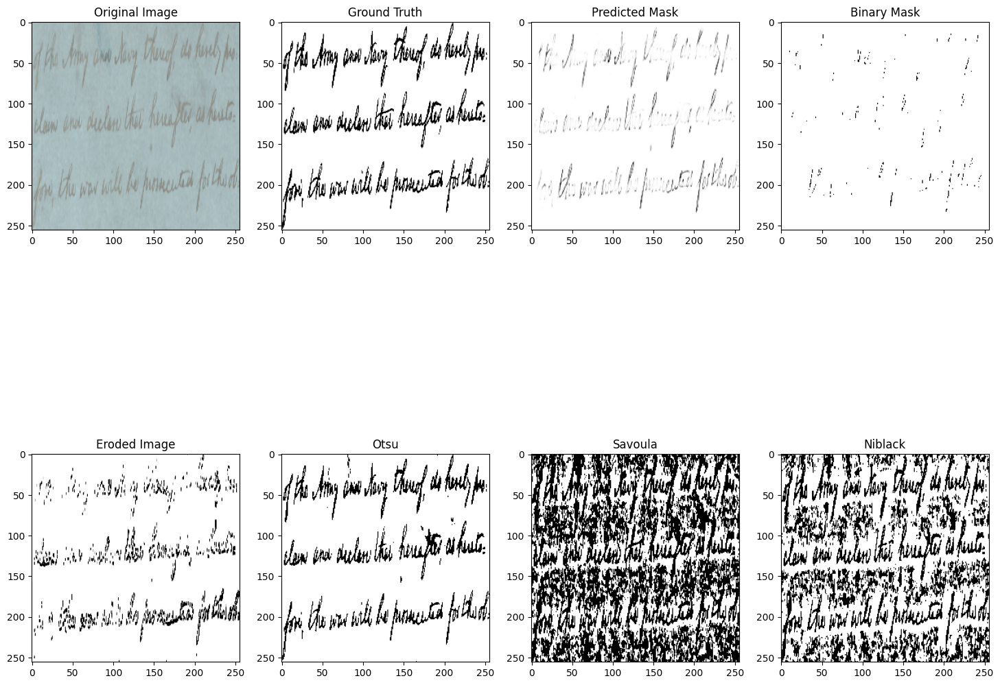

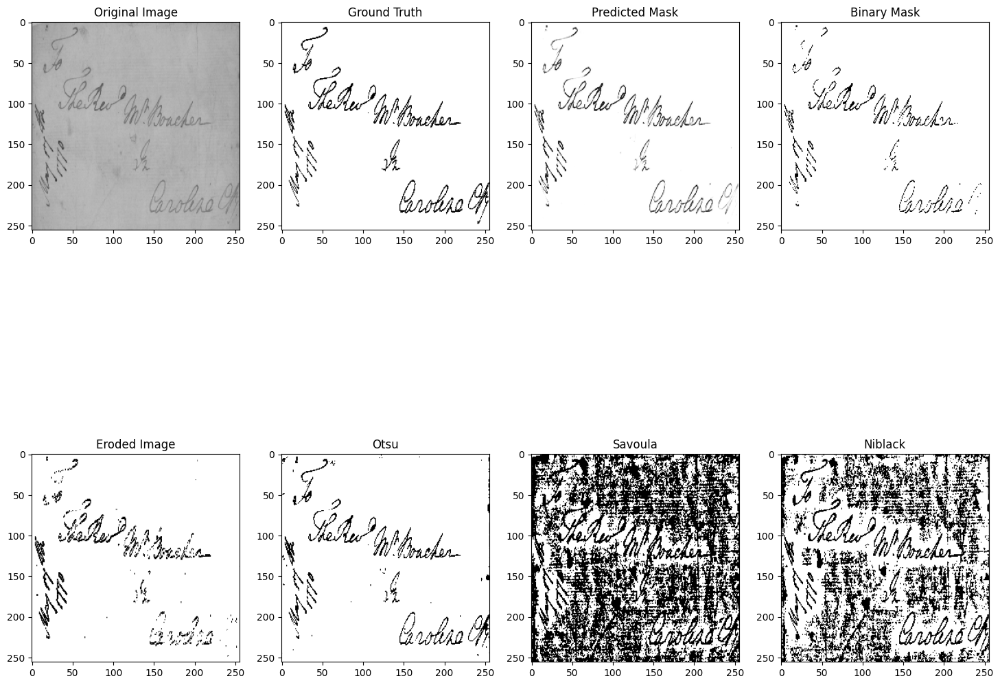

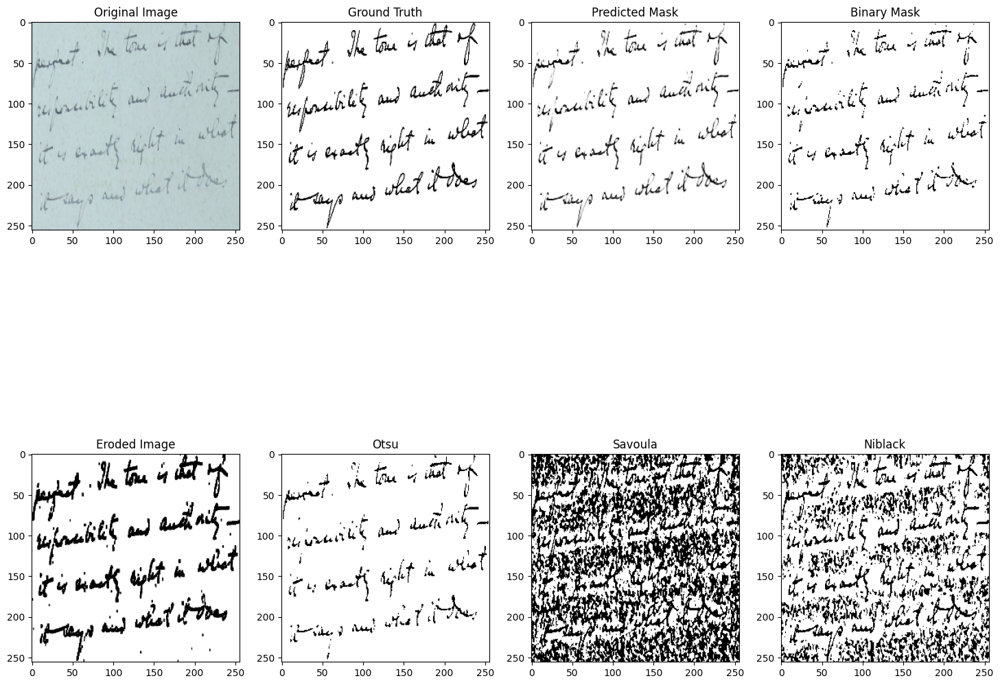

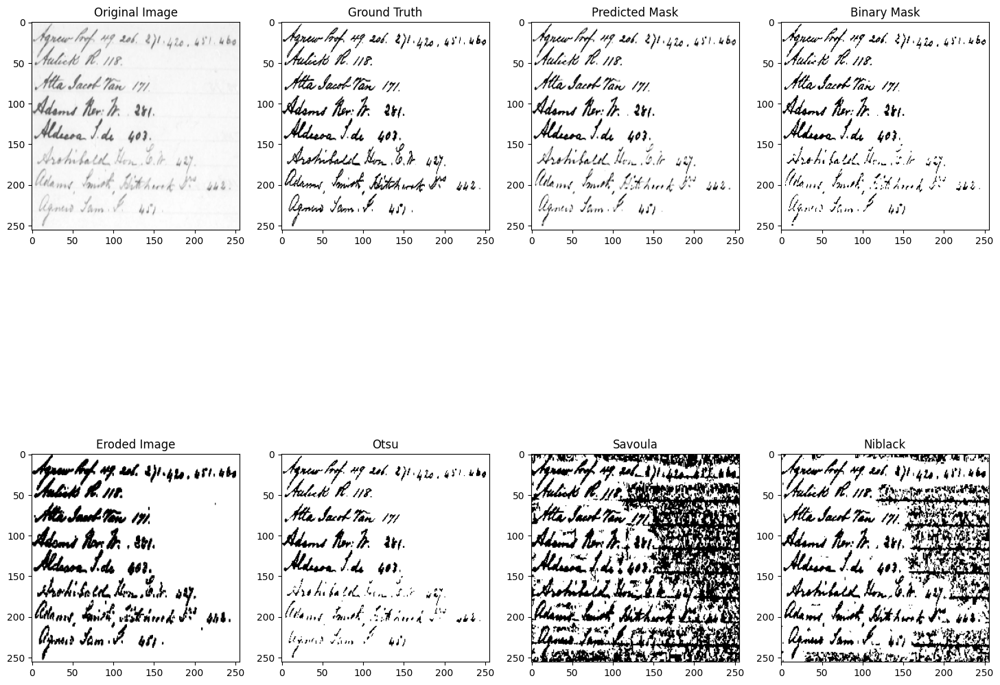

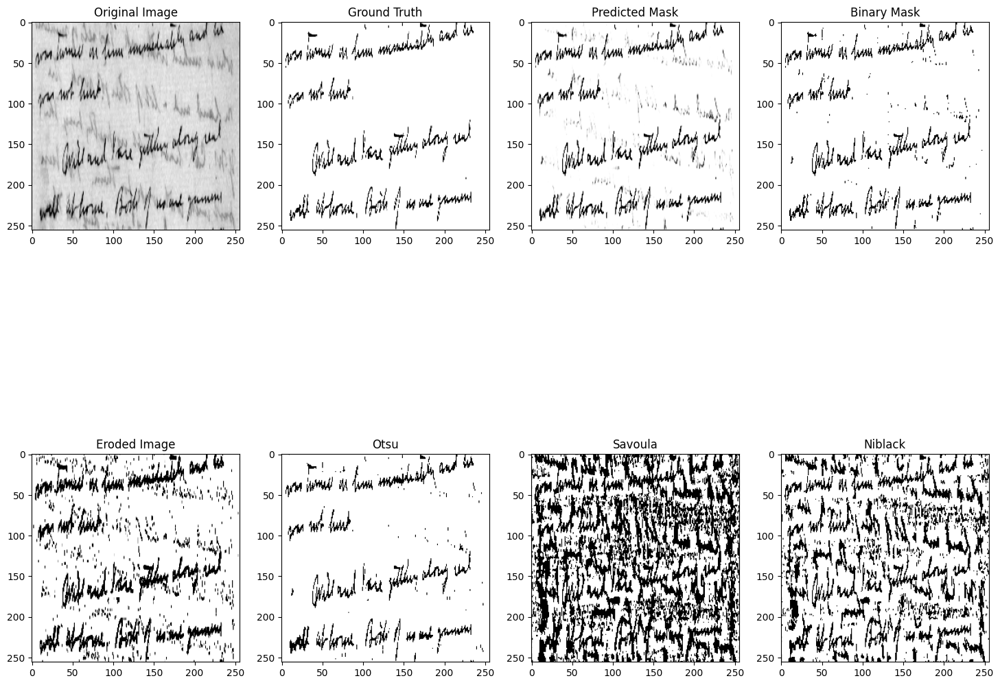

...

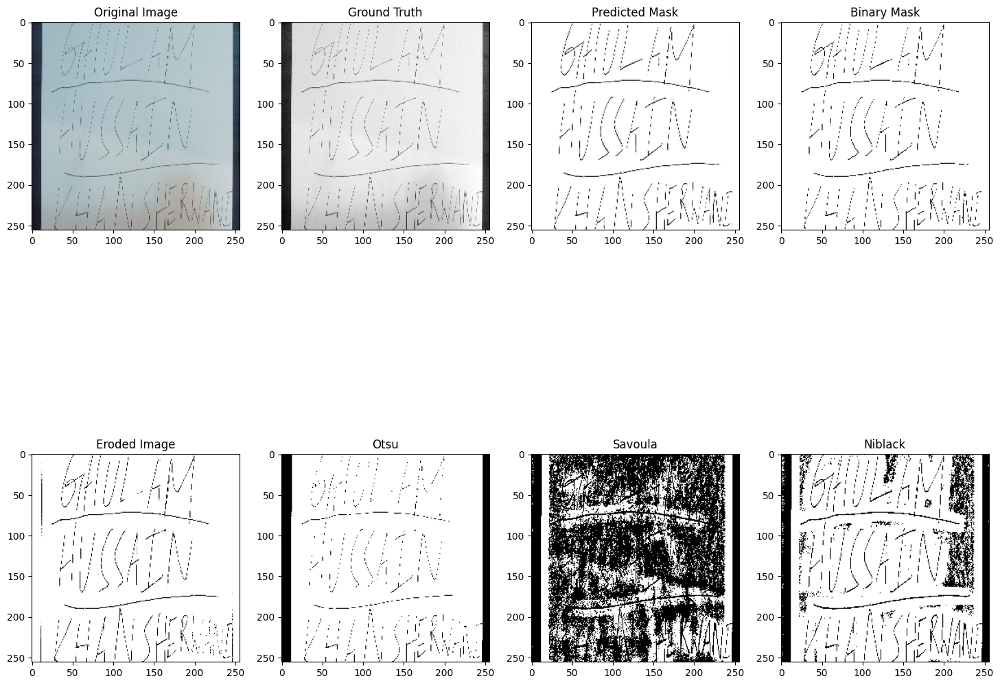

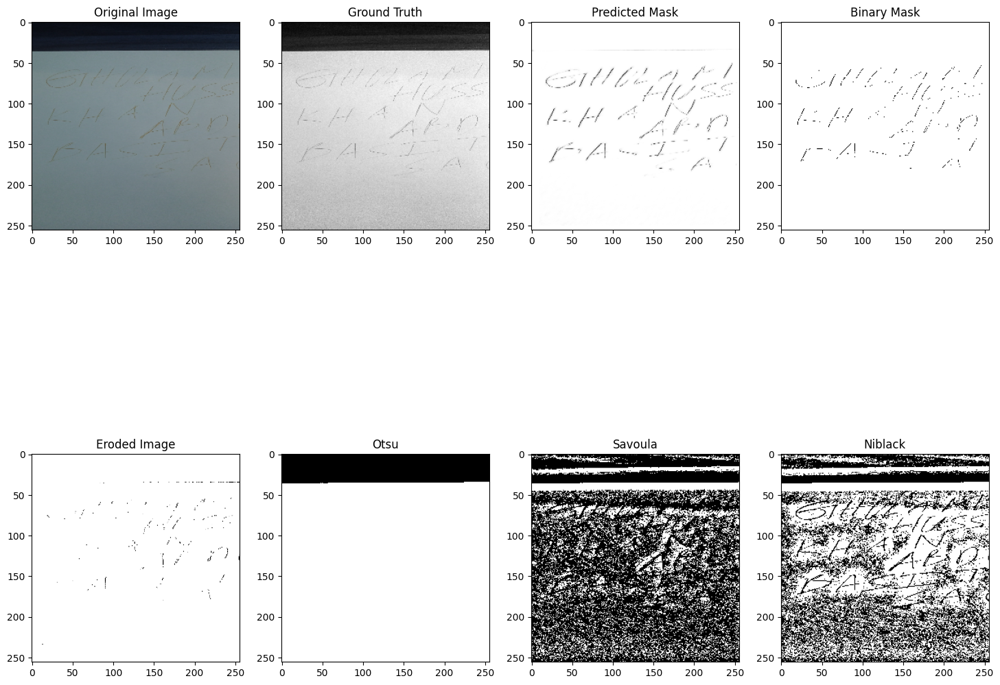

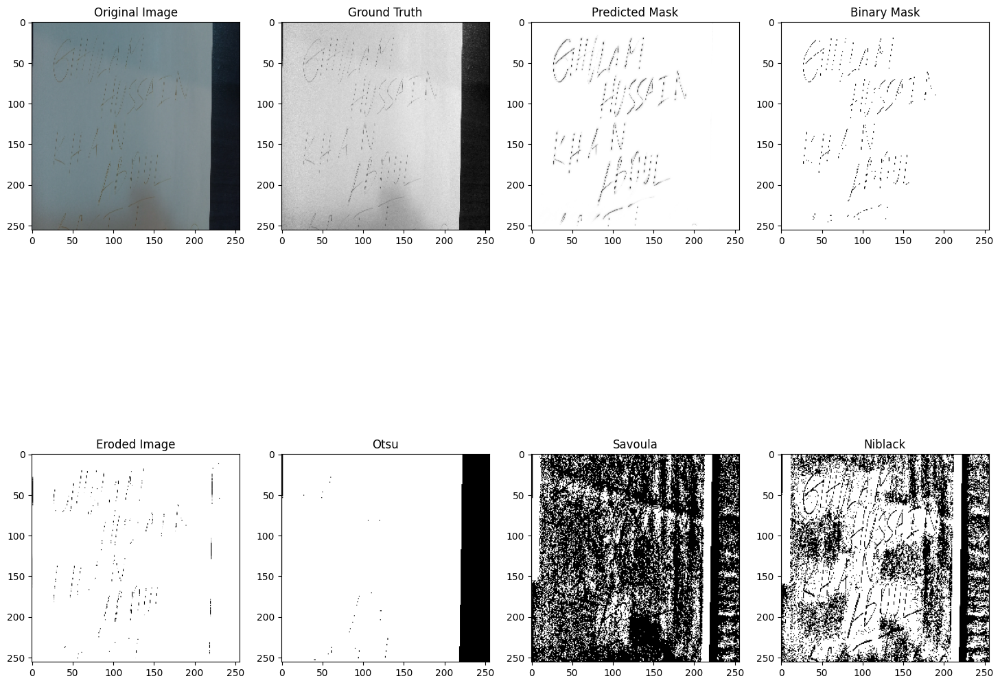

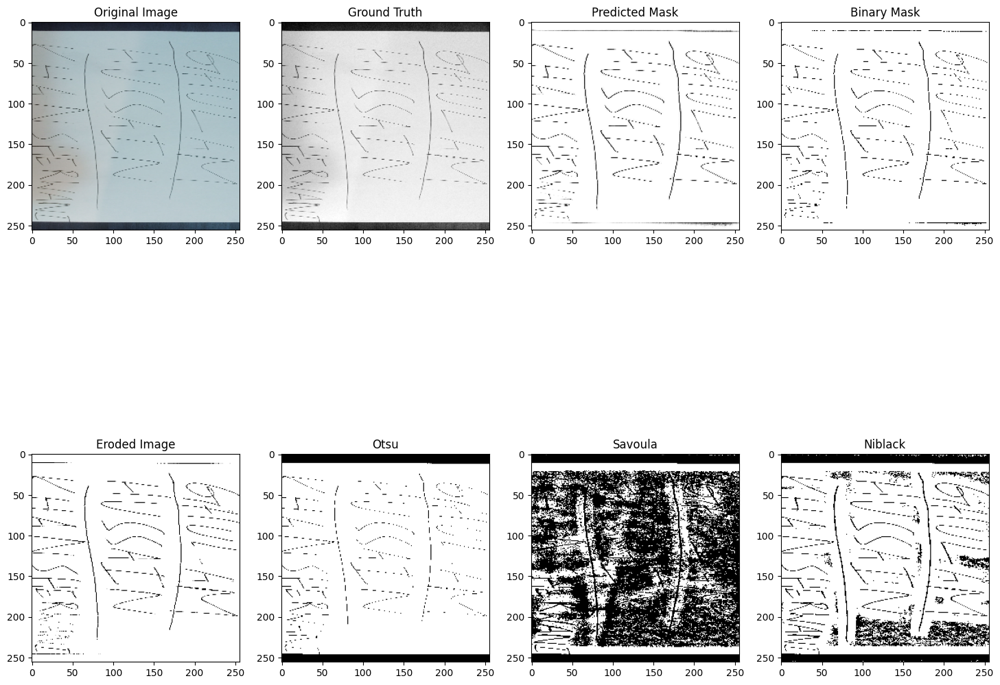

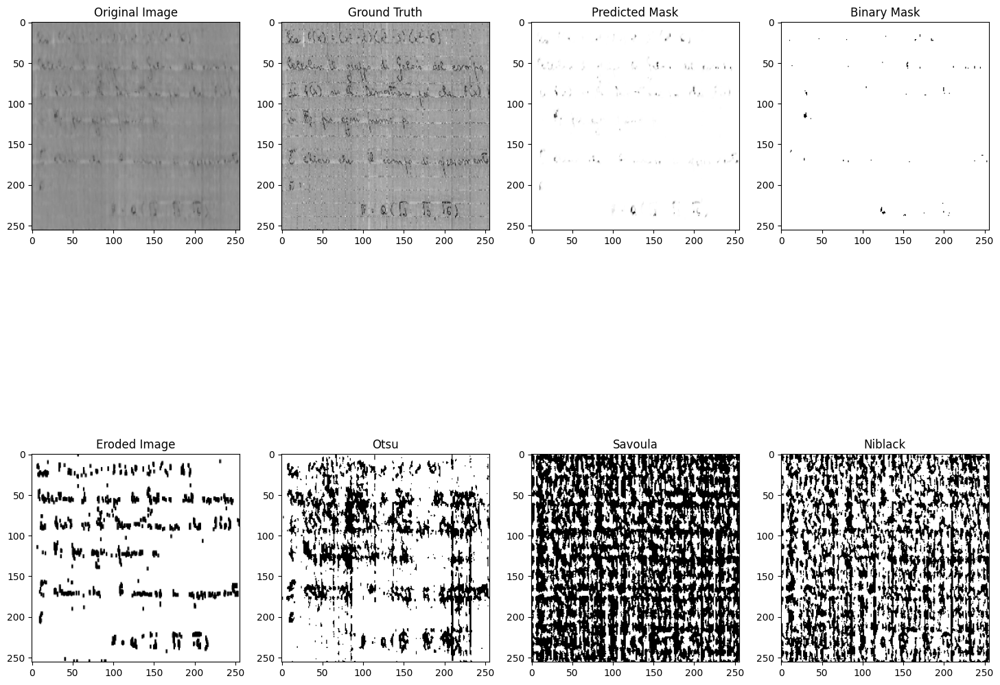

In [ ]:
# Path to the folder containing images
folder_path = '/content/gdrive/MyDrive/project/images'

# Get sorted list of file paths for images
image_paths = [os.path.join(folder_path, img) for img in sorted(os.listdir(folder_path))]

eroded_images = []
otsu_images = []
sauvola_images = []
niblack_images = []

# Iterate through all images in the folder
for image_path in image_paths:
        # Process and binarize the image
        _, _, _, eroded_img, otsu_img, sauvola_img, niblack_img = process_and_binarize_image(image_path)

        # Append images to respective lists
        eroded_images.append(eroded_img)
        otsu_images.append(otsu_img)
        sauvola_images.append(sauvola_img)
        niblack_images.append(niblack_img)

# Convert lists to numpy arrays
eroded_images = np.array(eroded_images)
otsu_images = np.array(otsu_images)
sauvola_images = np.array(sauvola_images)
niblack_images = np.array(niblack_images)
visualize_results(X_test, y_test,predictions2,thresholded_predictions2,eroded_images,otsu_images,sauvola_images,niblack_images)